In [1]:
import cv2#pip install opencv-python
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
import pandas as pd
import IPython.display as ipd
import librosa #pip install librosa
from midiutil import MIDIFile #pip install MIDIUtil
import random
from pedalboard import Pedalboard, Chorus, Reverb #pip install pedalboard
from pedalboard.io import AudioFile

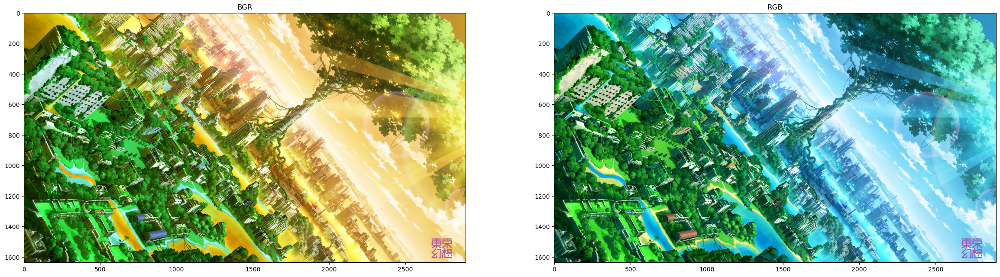

           Image Properties
Height =  1636 Width =  2896
Number of pixels in image =  4737856


In [65]:
ori_img = cv2.imread(r"C:\Users\akshi\Desktop\Wallpapers\313391.jpg")
img = cv2.cvtColor(ori_img, cv2.COLOR_BGR2RGB)
height, width, depth = img.shape
dpi = plt.rcParams['figure.dpi']
figsize = width / float(dpi), height / float(dpi)
fig, axs = plt.subplots(1, 2, figsize = figsize)
axs[0].title.set_text('BGR') 
axs[0].imshow(ori_img)
axs[1].title.set_text('RGB') 
axs[1].imshow(img)
plt.show()
print('Image Properties:')
print('Height =',height, 'Width =', width)
print('Number of pixels in image =', height * width)

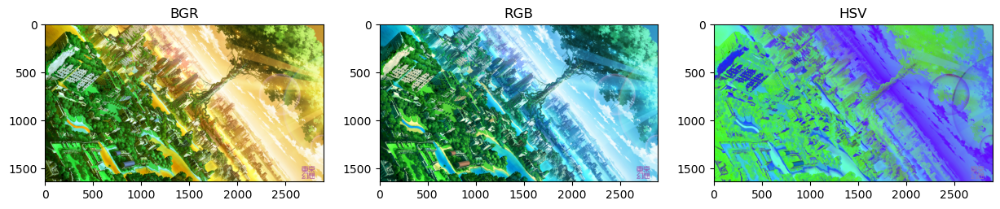

[[ 97 254 192]
 [ 97 255 191]
 [ 97 255 191]
 ...
 [ 98 199 197]
 [ 98 199 197]
 [ 98 200 196]]


In [66]:
hsv = cv2.cvtColor(ori_img, cv2.COLOR_BGR2HSV)
fig, axs = plt.subplots(1, 3, figsize = (15,15))
names = ['BGR','RGB','HSV']
imgs  = [ori_img, img, hsv]
i = 0
for elem in imgs:
    axs[i].title.set_text(names[i])
    axs[i].imshow(elem)
    axs[i].grid(False)
    i += 1
plt.show()
print(hsv[1])

In [67]:
i=0 ; j=0
hues = [] 
for i in range(height):
    for j in range(width):
        hue = hsv[i][j][0]
        hues.append(hue)
print(hues)

[97, 97, 97, 97, 97, 97, 98, 98, 98, 98, 98, 97, 97, 97, 97, 97, 97, 98, 98, 98, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 96, 96, 96, 96, 96, 96, 96, 96, 96, 96, 96, 96, 96, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 96, 96, 96, 96, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 95, 96, 95, 95, 95, 95, 95, 95, 95, 95, 94, 94, 94, 94, 94, 94, 94, 94, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 94, 93, 93, 93, 94, 94, 94, 94, 94, 94, 94, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 93, 94, 93, 92, 93, 93, 93, 93, 93, 93, 92, 93, 93, 93, 93, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 92, 91, 92, 92, 92, 92, 92, 91, 91, 91, 91, 91, 91, 91, 90, 89, 89, 88, 88, 87, 86, 85, 84, 84, 82, 81, 79, 78, 77, 76, 76, 73, 76, 79, 77, 78, 77, 77, 76, 74, 74, 73, 71, 72, 75, 74, 70, 69, 69,

In [68]:
pixels_df = pd.DataFrame(hues,columns=['hues'])
pixels_df

,hues
0,97
1,97
2,97
3,97
4,97
...,...
4737851,94
4737852,96
4737853,97
4737854,97


In [69]:

def hue2freq(h,scale_freqs):
    thresholds = [26 , 52 , 78 , 104,  128 , 154 , 180]
    note = scale_freqs[0]
    if (h <= thresholds[0]):
         note = scale_freqs[0]
    elif (h > thresholds[0]) & (h <= thresholds[1]):
        note = scale_freqs[1]
    elif (h > thresholds[1]) & (h <= thresholds[2]):
        note = scale_freqs[2]
    elif (h > thresholds[2]) & (h <= thresholds[3]):
        note = scale_freqs[3]
    elif (h > thresholds[3]) & (h <= thresholds[4]):    
        note = scale_freqs[4]
    elif (h > thresholds[4]) & (h <= thresholds[5]):
        note = scale_freqs[5]
    elif (h > thresholds[5]) & (h <= thresholds[6]):
        note = scale_freqs[6]
    else:
        note = scale_freqs[0]
    
    return note

In [70]:
def img2music(img, scale = [261.63, 293.66,311.13, 349.23,392.00,415.30,493.88,523.25],
              sr = 22050, T = 0.1, nPixels = 60, useOctaves = True, randomPixels = False,
              harmonize = 'U0'):
    hsv = cv2.cvtColor(ori_img, cv2.COLOR_BGR2HSV)
    
    
    height, width, depth = ori_img.shape

    i=0 ; j=0 ;
    hues = [] 
    for i in range(height):
        for j in range(width):
            hue = hsv[i][j][0] 
            hues.append(hue)
            
    
    pixels_df = pd.DataFrame(hues, columns=['hues'])
    pixels_df['frequencies'] = pixels_df.apply(lambda row : hue2freq(row['hues'],scale), axis = 1) 
    frequencies = pixels_df['frequencies'].to_numpy()
    harmony_select = {'U0' : 1,
                      'ST' : 16/15,
                      'M2' : 9/8,
                      'm3' : 6/5,
                      'M3' : 5/4,
                      'P4' : 4/3,
                      'DT' : 45/32,
                      'P5' : 3/2,
                      'm6': 8/5,
                      'M6': 5/3,
                      'm7': 9/5,
                      'M7': 15/8,
                      'O8': 2
                     }
    harmony = np.array([]) #This array will contain the song harmony
    harmony_val = harmony_select[harmonize] #This will select the ratio for the desired harmony
                                               
    song_freqs = np.array([]) #This array will contain the chosen frequencies used in our song :]
    song = np.array([])       #This array will contain the song signal
    octaves = np.array([0.5,1,2])#Go an octave below, same note, or go an octave above
    t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
    #Make a song with numpy array :]
    #nPixels = int(len(frequencies))#All pixels in image
    for k in range(nPixels):
        if useOctaves:
            octave = random.choice(octaves)
        else:
            octave = 1
        
        if randomPixels == False:
            val =  octave * frequencies[k]
        else:
            val = octave * random.choice(frequencies)
            
        #Make note and harmony note    
        note   = 0.5*np.sin(2*np.pi*val*t)
        h_note = 0.5*np.sin(2*np.pi*harmony_val*val*t)  
        
        #Place notes into corresponfing arrays
        song       = np.concatenate([song, note])
        harmony    = np.concatenate([harmony, h_note])                                     
        #song_freqs = np.concatenate([song_freqs, val])
                                               
    return song, pixels_df, harmony

In [71]:
def get_piano_notes():   
    # White keys are in Uppercase and black keys (sharps) are in lowercase
    octave = ['C', 'c', 'D', 'd', 'E', 'F', 'f', 'G', 'g', 'A', 'a', 'B'] 
    base_freq = 440 #Frequency of Note A4
    keys = np.array([x+str(y) for y in range(0,9) for x in octave])
    # Trim to standard 88 keys
    start = np.where(keys == 'A0')[0][0]
    end = np.where(keys == 'C8')[0][0]
    keys = keys[start:end+1]
    
    note_freqs = dict(zip(keys, [2**((n+1-49)/12)*base_freq for n in range(len(keys))]))
    note_freqs[''] = 0.0 # stop
    return note_freqs

def get_sine_wave(frequency, duration, sample_rate=44100, amplitude=4096):
    t = np.linspace(0, duration, int(sample_rate*duration)) # Time axis
    wave = amplitude*np.sin(2*np.pi*frequency*t)
    return wave


In [72]:
def makeScale(whichOctave, whichKey, whichScale, makeHarmony = 'U0'):
    
    #Load note dictionary
    note_freqs = get_piano_notes()
    
    #Define tones. Upper case are white keys in piano. Lower case are black keys
    scale_intervals = ['A','a','B','C','c','D','d','E','F','f','G','g']
    
    #Find index of desired key
    index = scale_intervals.index(whichKey)
    
    #Redefine scale interval so that scale intervals begins with whichKey
    new_scale = scale_intervals[index:12] + scale_intervals[:index]
    
    #Choose scale
    if whichScale == 'AEOLIAN':
        scale = [0, 2, 3, 5, 7, 8, 10]
    elif whichScale == 'BLUES':
        scale = [0, 2, 3, 4, 5, 7, 9, 10, 11]
    elif whichScale == 'PHYRIGIAN':
        scale = [0, 1, 3, 5, 7, 8, 10]
    elif whichScale == 'CHROMATIC':
        scale = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]
    elif whichScale == 'DIATONIC_MINOR':
        scale = [0, 2, 3, 5, 7, 8, 10]
    elif whichScale == 'DORIAN':
        scale = [0, 2, 3, 5, 7, 9, 10]
    elif whichScale == 'HARMONIC_MINOR':
        scale = [0, 2, 3, 5, 7, 8, 11]
    elif whichScale == 'LYDIAN':
        scale = [0, 2, 4, 6, 7, 9, 11]
    elif whichScale == 'MAJOR':
        scale = [0, 2, 4, 5, 7, 9, 11]
    elif whichScale == 'MELODIC_MINOR':
        scale = [0, 2, 3, 5, 7, 8, 9, 10, 11]
    elif whichScale == 'MINOR':    
        scale = [0, 2, 3, 5, 7, 8, 10]
    elif whichScale == 'MIXOLYDIAN':     
        scale = [0, 2, 4, 5, 7, 9, 10]
    elif whichScale == 'NATURAL_MINOR':   
        scale = [0, 2, 3, 5, 7, 8, 10]
    elif whichScale == 'PENTATONIC':    
        scale = [0, 2, 4, 7, 9]
    else:
        print('Invalid scale name')
    
    #Make harmony dictionary (i.e. fundamental, perfect fifth, major third, octave)
    #unison           = U0
    #semitone         = ST
    #major second     = M2
    #minor third      = m3
    #major third      = M3
    #perfect fourth   = P4
    #diatonic tritone = DT
    #perfect fifth    = P5
    #minor sixth      = m6
    #major sixth      = M6
    #minor seventh    = m7
    #major seventh    = M7
    #octave           = O8
    harmony_select = {'U0' : 1,
                      'ST' : 16/15,
                      'M2' : 9/8,
                      'm3' : 6/5,
                      'M3' : 5/4,
                      'P4' : 4/3,
                      'DT' : 45/32,
                      'P5' : 3/2,
                      'm6': 8/5,
                      'M6': 5/3,
                      'm7': 9/5,
                      'M7': 15/8,
                      'O8': 2
                     }
    
    #Get length of scale (i.e., how many notes in scale)
    nNotes = len(scale)
    
    #Initialize arrays
    freqs = []
    #harmony = []
    #harmony_val = harmony_select[makeHarmony]
    for i in range(nNotes):
        note = new_scale[scale[i]] + str(whichOctave)
        freqToAdd = note_freqs[note]
        freqs.append(freqToAdd)
        #harmony.append(harmony_val*freqToAdd)
    return freqs#,harmony

In [73]:
test_scale,test_harmony = makeScale(3, 'a', 'HARMONIC_MINOR',makeHarmony = 'm6')
print(test_scale)
print(test_harmony)

ValueError: too many values to unpack (expected 2)

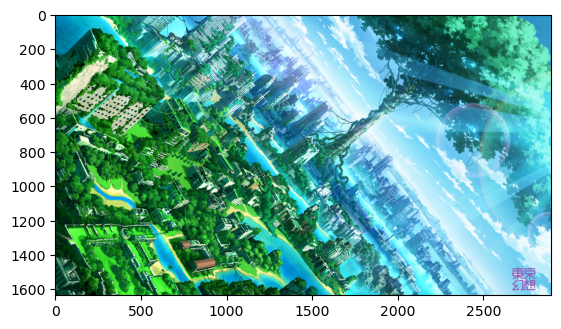

In [74]:
anime_art = cv2.imread(r"C:\Users\akshi\Desktop\Wallpapers\313391.jpg")
anime_art2 = cv2.cvtColor(pixel_art, cv2.COLOR_BGR2RGB)
plt.figure()
plt.imshow(anime_art2)
plt.grid(False)
plt.show()

In [77]:
anime_scale = makeScale(3, 'A', 'HARMONIC_MINOR')
anime_song, anime_df,anime_df_harmony = img2music(anime_art, 
                                                  anime_scale, 
                                                  T = 0.2, 
                                                  randomPixels = True)

wavfile.write('anime_song2.wav'    , rate = 22050, data = anime_song.astype(np.float32))
ipd.Audio(anime_song, rate = sr)

In [78]:
anime_df

,hues,frequencies
0,97,146.832384
1,97,146.832384
2,97,146.832384
3,97,146.832384
4,97,146.832384
...,...,...
4737851,94,146.832384
4737852,96,146.832384
4737853,97,146.832384
4737854,97,146.832384
